In [1]:
from pyzbar.pyzbar import decode
from PIL import Image
import numpy as np

import zxingcpp
import cv2
import os
from matplotlib import pyplot as plt

In [2]:
bd = cv2.barcode.BarcodeDetector()

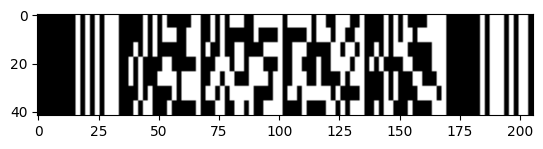

[('PDF417', '1234567')]


In [3]:
img = cv2.cvtColor(cv2.imread('generated_codes/PDF417_1234567.png'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()
result = zxingcpp.read_barcodes(img)
if result:
    print([(r.format.name.upper(), r.text) for r in  result])

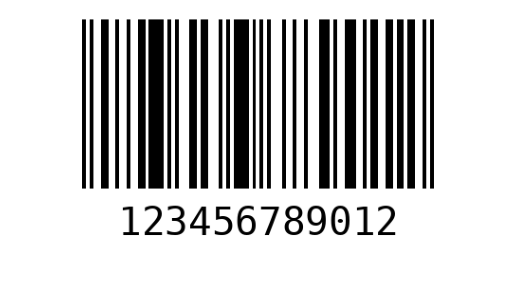

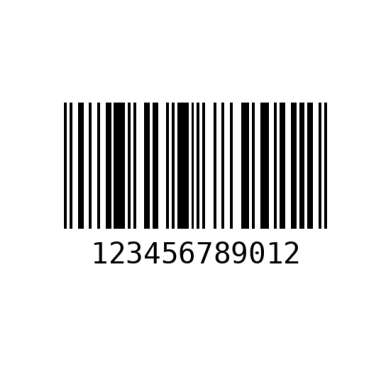

[('UPCA', '123456789012')]


In [4]:
path = 'generated_codes/UPCA_123456789012.png.png'
img = cv2.cvtColor(cv2.imread(path), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis(False)
plt.show()
padding = (np.abs(np.array(img.shape[:-1]) - max(img.shape[:-1])) / 2).astype(int)
img = np.pad(img, [(padding[0], padding[0]), (padding[1], padding[1]), (0, 0)], mode='constant', constant_values=np.max(img))
plt.imshow(img)
plt.axis(False)
plt.show()
result = zxingcpp.read_barcodes(img)
if result:
    print([(r.format.name.upper(), r.text) for r in  result])

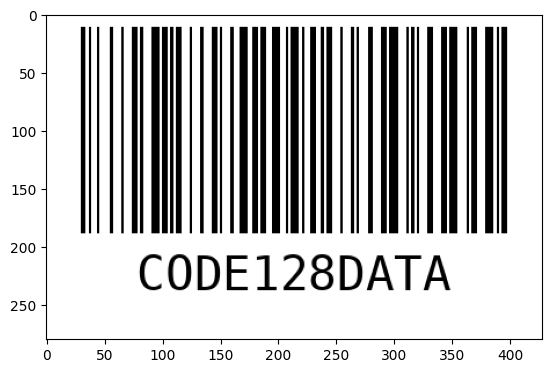

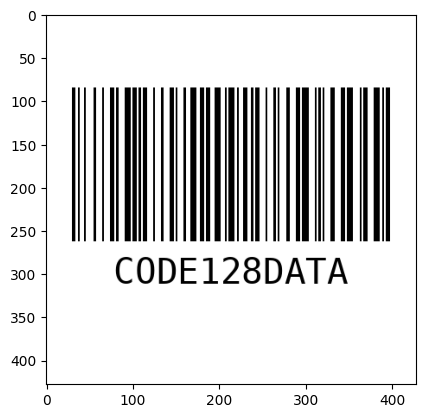

[('CODE128', 'CODE128DATA')]


In [5]:
img = cv2.cvtColor(cv2.imread('image-8.png'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()
padding = (np.abs(np.array(img.shape[:-1]) - max(img.shape[:-1])) / 2).astype(int)
img = np.pad(img, [(padding[0], padding[0]), (padding[1], padding[1]), (0, 0)], mode='maximum')
plt.imshow(img)
plt.show()
result = zxingcpp.read_barcodes(img)
if result:
    print([(r.format.name.upper(), r.text) for r in  result])

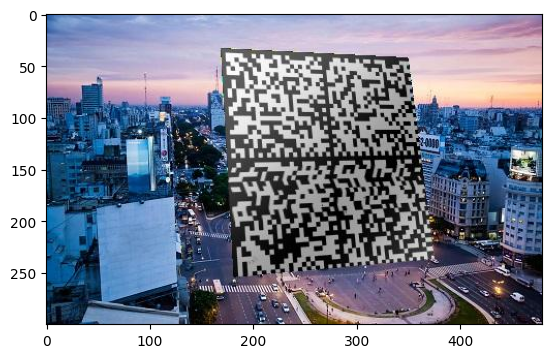

In [6]:
img = cv2.cvtColor(cv2.imread('/home/lbelkov/MIPT/cv/mipt2024s-5-plokhotnyuk-v-o/code/test.jpg'), cv2.COLOR_BGR2RGB)
plt.imshow(img)
result = zxingcpp.read_barcodes(img)
if result:
    print([(r.format.name.upper(), r.text) for r in  result])


download (10).png


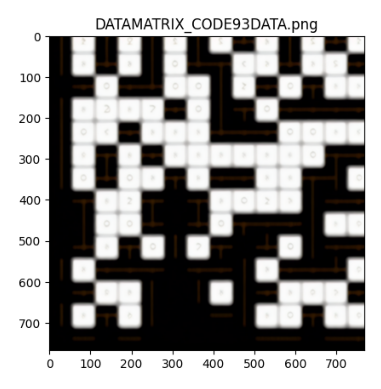


download (5).png


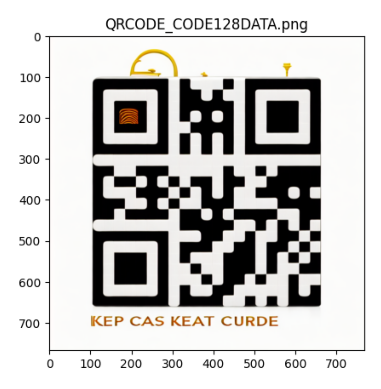

['QRCODE']

download (11).png


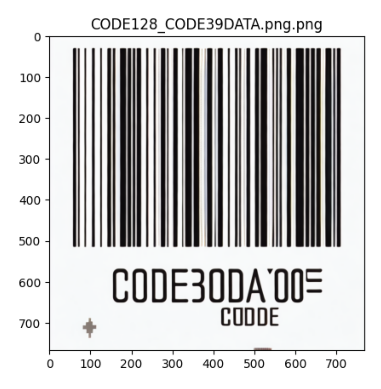


download (8).png


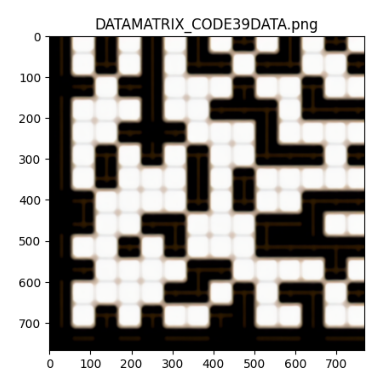


download (15).png


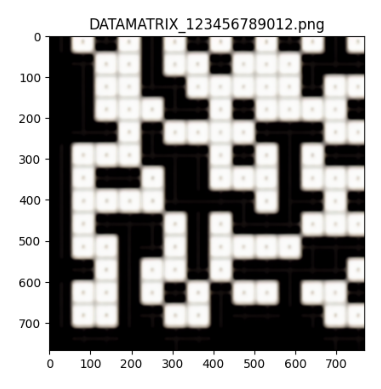


download (2).png


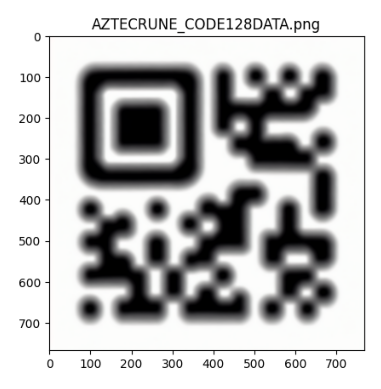

[('MICROQRCODE', 'CODE128DATA')]

download (6).png


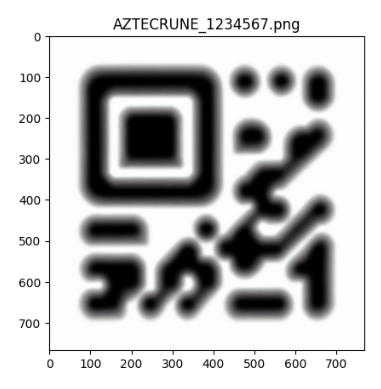

[('MICROQRCODE', '1234567')]

download (16).png


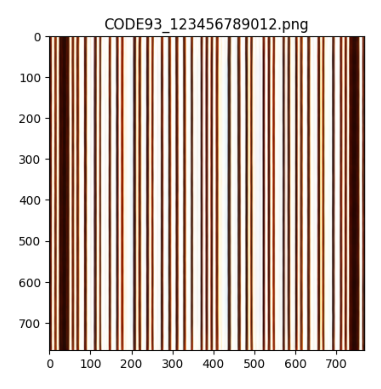

['EAN13'] (True, ('3843161778862',), ('EAN_13',), array([[[  8.8033905, 398.0042   ],
        [  8.796585 ,  38.00421  ],
        [455.1966   ,  37.99579  ],
        [455.20343  , 397.9958   ]]], dtype=float32))

download (4).png


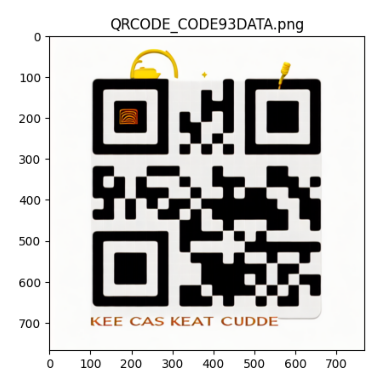

['QRCODE']

download (14).png


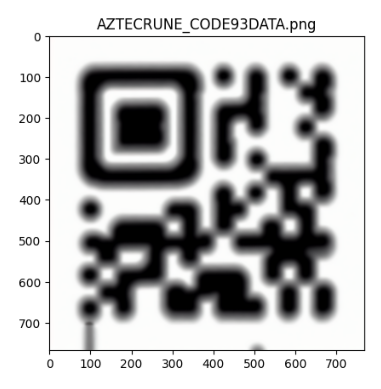


download (9).png


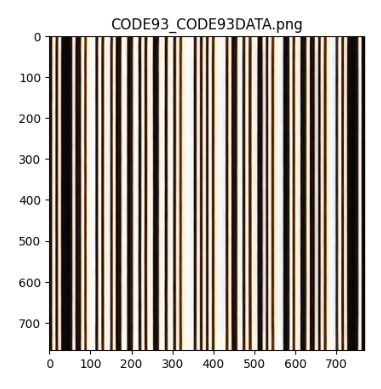


download (7).png


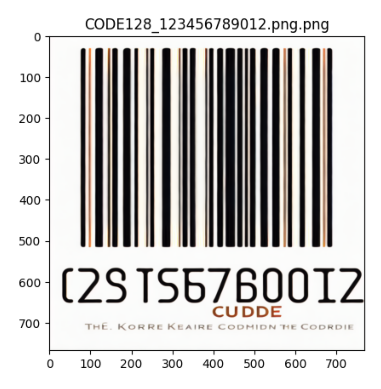

[('CODE128', '123456789012')]

download.png


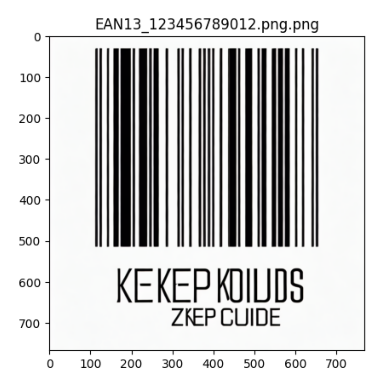

['EAN13'] (True, ('1234567890128',), ('EAN_13',), array([[[ 95.19867 , 254.99817 ],
        [ 95.201294,  50.99817 ],
        [380.80133 ,  51.00183 ],
        [380.7987  , 255.00183 ]]], dtype=float32))
['EAN13']

download (12).png


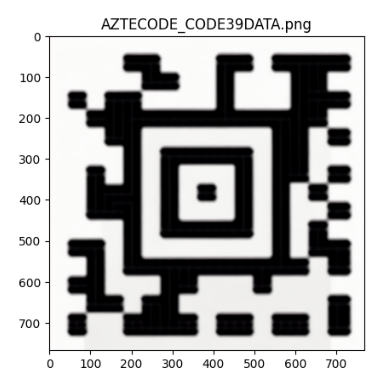

[('AZTEC', 'CODE39DATA')]

download (1).png


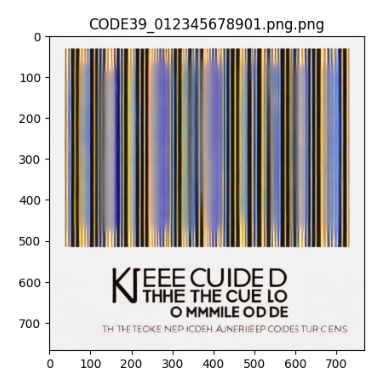


download (3).png


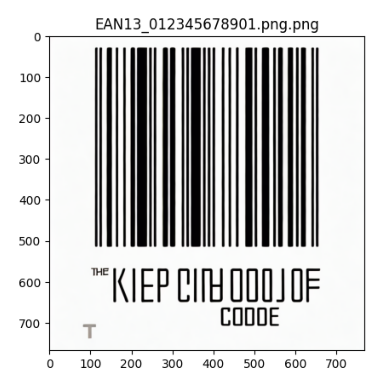


download (13).png


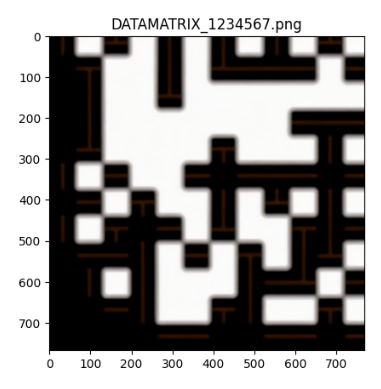

In [7]:
root, _, pimgs = list(os.walk('data/'))[0]
for pimg in pimgs:
    if 'download' in pimg:
        print(f'\n{pimg}')
        path = f'{root}/{pimg}'
        img = cv2.imread(path)
        plt.imshow(img)
        plt.axis('off')
        plt.show()
        result = zxingcpp.read_barcodes(img)
        if result:
            print([(r.format.name.upper(), r.text) for r in  result])
        result = bd.detectAndDecodeWithType(img)
        if result[0]:
            r = list(map(lambda r: ''.join(r.split('_')), filter(lambda r: len(r) > 0, result[2])))
            print(r, result)
        img = Image.fromarray(img)
        result = decode(img)
        if result:
            print([r[1] for r in  result])

('MICROQRCODE', 'CODE93DATA')

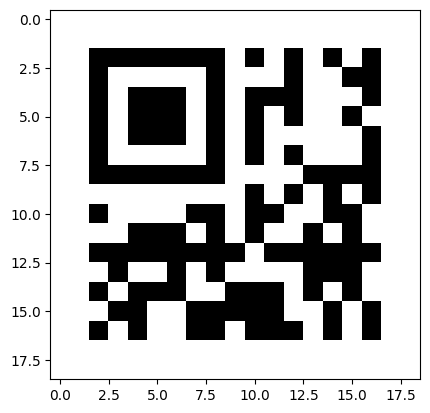

In [8]:
img = cv2.imread('data/AZTECRUNE_CODE93DATA.png')
result = zxingcpp.read_barcodes(img)

plt.imshow(img[..., ::-1])

result[0].format.name.upper(), result[0].text

('AZTEC', '1234567')

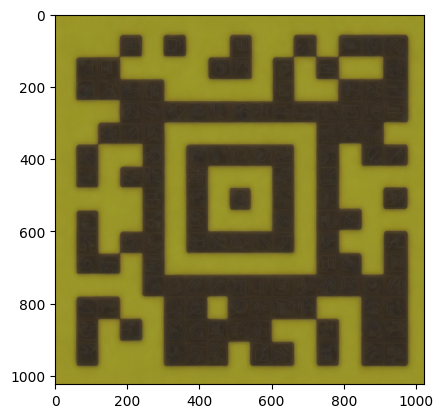

In [9]:
img = cv2.imread('data/aztec_green.png')
result = zxingcpp.read_barcodes(img)

plt.imshow(img[..., ::-1])

result[0].format.name.upper(), result[0].text

('CODE39', 'CODE39DATA8')

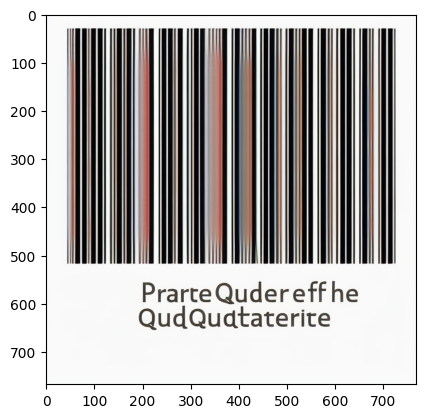

In [10]:
img = cv2.imread('data/image.png')
result = zxingcpp.read_barcodes(img)

plt.imshow(img[..., ::-1])

result[0].format.name.upper(), result[0].text

In [11]:
decoded = dict()
img_list = []

for root, _, pimgs in list(os.walk('data/'))[2:]:
    for pimg in pimgs:
        if pimg[-4:] in ('.jpg', '.png'):
            img_list.append(pimg[:-4])
            path = f'{root}/{pimg}'
            
            img = cv2.imread(f'{root}/{pimg}')

            result = zxingcpp.read_barcodes(img)
            if result:
                decoded[pimg[:-4]] = [r.format.name.upper() for r in result]

            result = bd.detectAndDecodeWithType(img)
            if result[0]:
                result = map(lambda r: ''.join(r.split('_')), filter(lambda r: len(r) > 0, result[2]))
                if pimg[:-4] in decoded:
                    decoded[pimg[:-4]] += list(filter(lambda r: r not in decoded[pimg[:-4]], result))
                else:
                    decoded[pimg[:-4]] = list(result)
            # img = Image.open(path)
            img = Image.fromarray(img)
            result = decode(img)
            if result:
                decoded[pimg[:-4]] = decoded.get(pimg[:-4], [])
                result = list(filter(lambda r: r not in decoded[pimg[:-4]], [r[1] for r in  result]))
                decoded[pimg[:-4]].extend(result)


In [12]:
decoded

{'IMG_20240221_072707_668': ['QRCODE'],
 'IMG_20240220_194751_642': ['QRCODE'],
 'IMG_20240220_194548_679': ['QRCODE'],
 'IMG20240220194325': ['QRCODE'],
 'photo_2024-02-20_20-16-08': ['QRCODE'],
 'IMG20240220194329': ['QRCODE'],
 'IMG20240220194318': ['QRCODE'],
 'IMG20240220194359': ['QRCODE'],
 'IMG_20240207_092624_696': ['QRCODE', 'QRCODE', 'QRCODE'],
 'IMG_20240220_194422_813': ['EAN13'],
 'IMG_20240220_194445_307': ['CODE128'],
 'IMG20240220194411': ['EAN13', 'EAN13', 'UPCA'],
 'IMG_20240220_194729_476': ['EAN13'],
 'IMG20240220194601': ['EAN13'],
 'IMG_20240220_194720_589': ['EAN13'],
 'IMG20240220194424': ['UPCA', 'EAN13'],
 'IMG20240220194625': ['EAN13'],
 'IMG20240220194441': ['CODE39', 'UPCA'],
 'IMG_20240220_194348_696': ['EAN13'],
 'IMG20240220194341': ['EAN13'],
 'IMG_20240220_194647_269': ['EAN13'],
 'IMG_20240219_003535_072': ['EAN13', 'EAN13', 'UPCA'],
 'IMG_20240220_195010_007': ['EAN13'],
 'IMG20240220194450': ['EAN13'],
 'IMG_20240220_194436_006': ['EAN13'],
 'IMG20

In [13]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

/tmp/ipykernel_789534/1349157543.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Code Type', y='Count', data=df, palette='viridis')


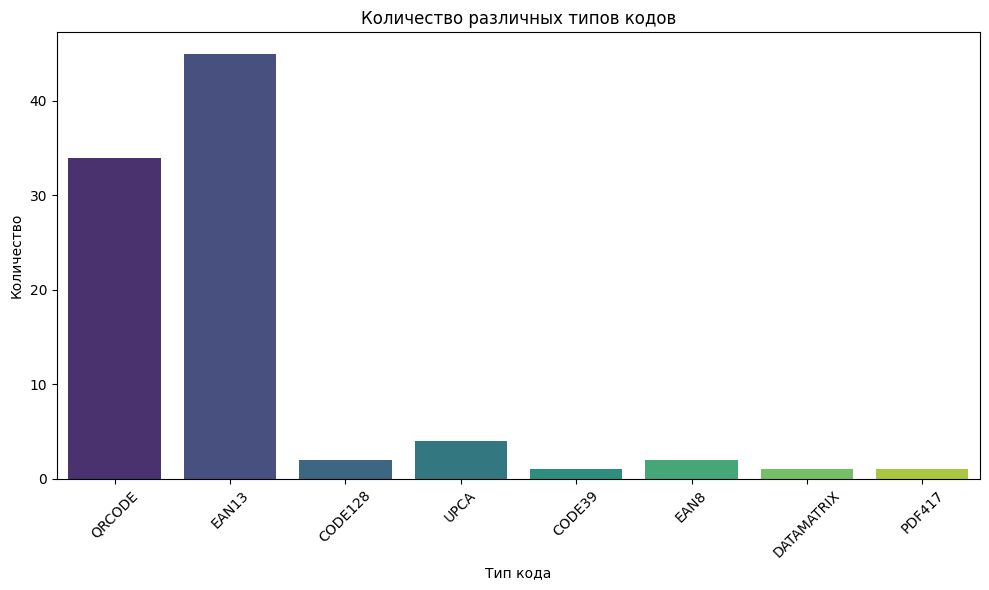

In [14]:
code_types = []
for codes in decoded.values():
    code_types.extend(codes)  # Добавляем все типы кодов в один список

# Подсчет количества каждого типа кода
code_counts = Counter(code_types)

# Создание DataFrame для визуализации
df = pd.DataFrame(code_counts.items(), columns=['Code Type', 'Count'])

# Построение barplot
plt.figure(figsize=(10, 6))
sns.barplot(x='Code Type', y='Count', data=df, palette='viridis')
plt.title('Количество различных типов кодов')
plt.xlabel('Тип кода')
plt.ylabel('Количество')
plt.xticks(rotation=45)
plt.tight_layout()  # Автоматическая настройка отступов

# Показать график
plt.show()

In [15]:
for code in sorted(set(code_types)):
    print(code, end=', ')

CODE128, CODE39, DATAMATRIX, EAN13, EAN8, PDF417, QRCODE, UPCA, 

In [16]:
for code in sorted(set(map(lambda code: code.upper(), ["ean13", "azteccode", "aztecrune", "qrcode", "code93", "datamatrix"]))):
    print(code, end=', ')

AZTECCODE, AZTECRUNE, CODE93, DATAMATRIX, EAN13, QRCODE, 

In [17]:
for code in set(code_types).union(set(map(lambda code: code.upper(), ["ean13", "azteccode", "aztecrune", "qrcode", "code93", "datamatrix"]))):
    print(code, end=', ')

EAN8, PDF417, QRCODE, CODE128, EAN13, UPCA, CODE93, AZTECRUNE, CODE39, AZTECCODE, DATAMATRIX, 

In [20]:
len(decoded)

75

In [21]:
len(img_list) + len(bad_imgs)

211

In [22]:
bad_imgs = set(img_list) - set(decoded)
len(img_list), len(bad_imgs)

(143, 68)

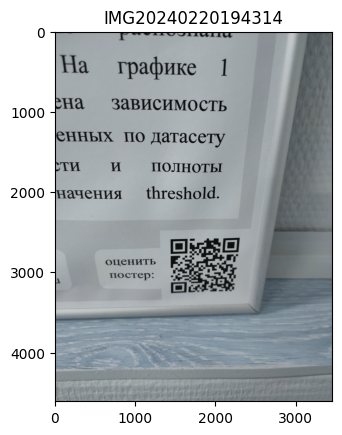

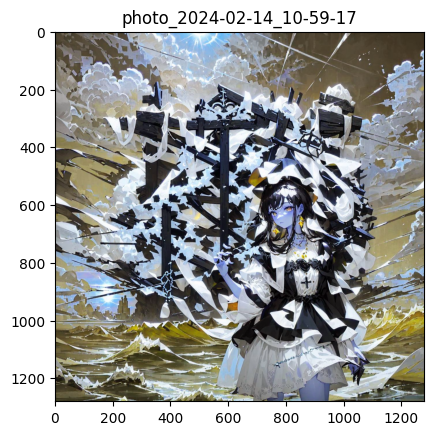

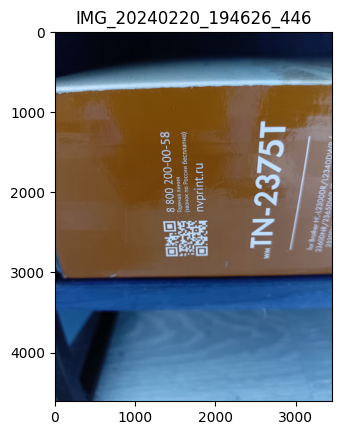

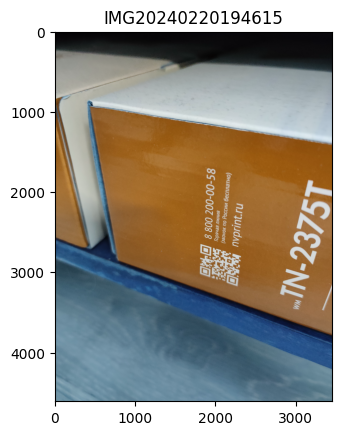

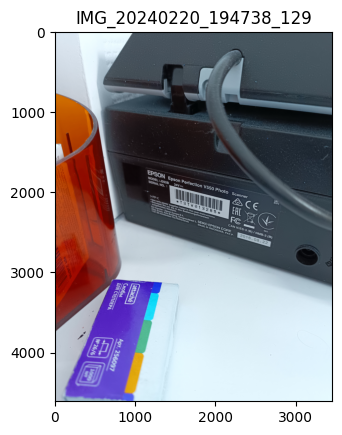

...

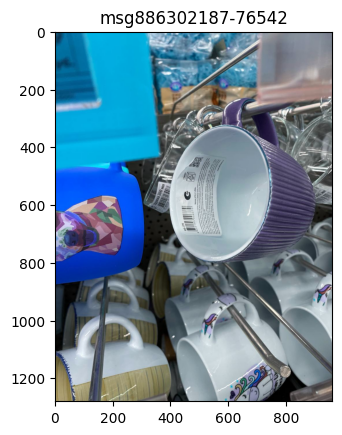

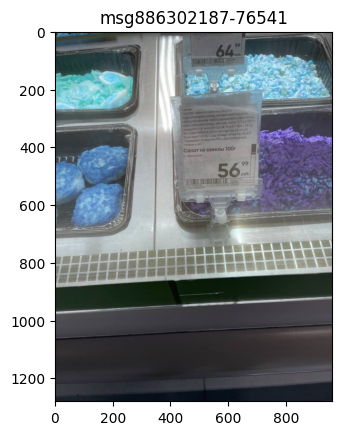

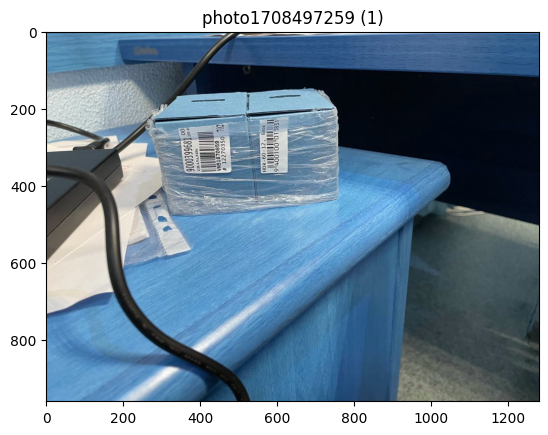

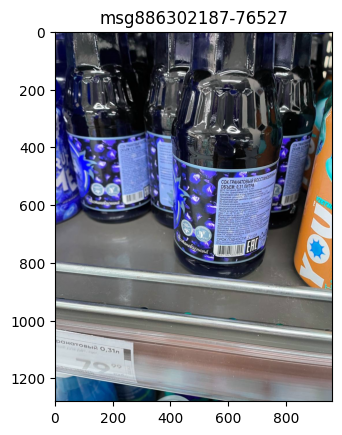

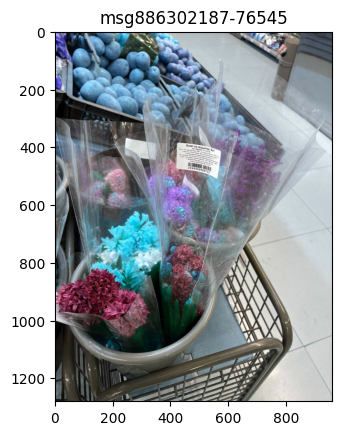

In [23]:
for root, _, pimgs in list(os.walk('data/'))[2:]:
    for pimg in pimgs:
        if pimg[:-4] in bad_imgs:
            img = cv2.imread(f'{root}/{pimg}')
            plt.imshow(img)
            plt.title(pimg[:-4])
            plt.show()